#Efficient SAM Example

This script provides example for how to get visualization result from EfficientSAM using weight file, part of the code is borrow from MobileSAM project, many thanks!

##Setup

In [8]:
import matplotlib.pyplot as plt
import numpy as np
import torch
from torchvision.transforms import ToTensor
from PIL import Image
import io
import os

#Box and Point prompt

In [3]:
def run_ours_box_or_points(img_path, pts_sampled, pts_labels, model):
    image_np = np.array(Image.open(img_path))
    img_tensor = ToTensor()(image_np)
    pts_sampled = torch.reshape(torch.tensor(pts_sampled), [1, 1, -1, 2])
    pts_labels = torch.reshape(torch.tensor(pts_labels), [1, 1, -1])
    predicted_logits, predicted_iou = model(
        img_tensor[None, ...],
        pts_sampled,
        pts_labels,
    )

    sorted_ids = torch.argsort(predicted_iou, dim=-1, descending=True)
    predicted_iou = torch.take_along_dim(predicted_iou, sorted_ids, dim=2)
    predicted_logits = torch.take_along_dim(
        predicted_logits, sorted_ids[..., None, None], dim=2
    )

    return torch.ge(predicted_logits[0, 0, 0, :, :], 0).cpu().detach().numpy()

#Visualization Related

In [4]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30 / 255, 144 / 255, 255 / 255, 0.8])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)


def show_points(coords, labels, ax, marker_size=375):
    pos_points = coords[labels == 1]
    neg_points = coords[labels == 0]
    ax.scatter(
        pos_points[:, 0],
        pos_points[:, 1],
        color="green",
        marker="*",
        s=marker_size,
        edgecolor="white",
        linewidth=1.25,
    )
    ax.scatter(
        neg_points[:, 0],
        neg_points[:, 1],
        color="red",
        marker="*",
        s=marker_size,
        edgecolor="white",
        linewidth=1.25,
    )


def show_box(box, ax):
    x0, y0 = box[0], box[1]
    w, h = box[2] - box[0], box[3] - box[1]
    ax.add_patch(
        plt.Rectangle((x0, y0), w, h, edgecolor="yellow", facecolor=(0, 0, 0, 0), lw=5)
    )

def show_anns_ours(mask, ax):
    ax.set_autoscale_on(False)
    img = np.ones((mask.shape[0], mask.shape[1], 4))
    img[:, :, 3] = 0
    color_mask = [0, 1, 0, 0.7]
    img[np.logical_not(mask)] = color_mask
    ax.imshow(img)


#Create the model and load the weights from the checkpoint.

In [5]:
!git clone https://github.com/yformer/EfficientSAM.git
import os
os.chdir("EfficientSAM")

Cloning into 'EfficientSAM'...
remote: Enumerating objects: 444, done.
remote: Counting objects: 100% (105/105), done.
remote: Compressing objects: 100% (48/48), done.
remote: Total 444 (delta 86), reused 65 (delta 57), pack-reused 339 (from 1)
Receiving objects: 100% (444/444), 263.09 MiB | 48.05 MiB/s, done.
Resolving deltas: 100% (256/256), done.
Updating files: 100% (39/39), done.


In [7]:
from efficient_sam.build_efficient_sam import build_efficient_sam_vitt, build_efficient_sam_vits
import zipfile

efficient_sam_vitt_model = build_efficient_sam_vitt()
efficient_sam_vitt_model.eval()

# Since EfficientSAM-S checkpoint file is >100MB, we store the zip file.
with zipfile.ZipFile("weights/efficient_sam_vits.pt.zip", 'r') as zip_ref:
    zip_ref.extractall("weights")
efficient_sam_vits_model = build_efficient_sam_vits()
efficient_sam_vits_model.eval()


/home/jovyan/workspace/EfficientSAM/efficient_sam/efficient_sam.py:303: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(f, map_location="cpu")


EfficientSam(
  (image_encoder): ImageEncoderViT(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 384, kernel_size=(16, 16), stride=(16, 16))
    )
    (blocks): ModuleList(
      (0-11): 12 x Block(
        (norm1): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=384, out_features=1152, bias=True)
          (proj): Linear(in_features=384, out_features=384, bias=True)
        )
        (norm2): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
        (mlp): Mlp(
          (fc1): Linear(in_features=384, out_features=1536, bias=True)
          (act): GELU(approximate='none')
          (fc2): Linear(in_features=1536, out_features=384, bias=True)
        )
      )
    )
    (neck): Sequential(
      (0): Conv2d(384, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (1): LayerNorm2d()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): LayerNorm2d()
    

## Box segmentation

prepare your own image here

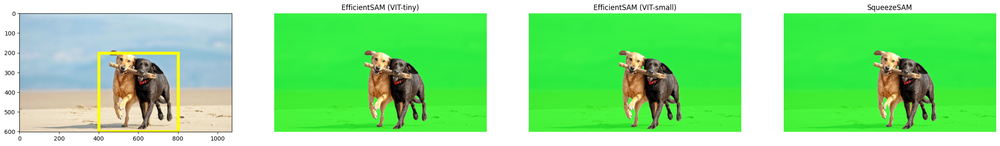

In [40]:
x1=400
y1=200
x2=800
y2=600
w=x2-x1
h=y2-y1

fig, ax = plt.subplots(1, 4, figsize=(30, 30))
input_point = np.array([[x1, y1], [x2, y2]])
input_label = np.array([2,3])
image_path = "figs/examples/dogs.jpg"
image = np.array(Image.open(image_path))
show_points(input_point, input_label, ax[0])
show_box([x1,y1,x2,y2], ax[0])
ax[0].imshow(image)


ax[1].imshow(image)
mask_efficient_sam_vitt = run_ours_box_or_points(image_path, input_point, input_label, efficient_sam_vitt_model)
show_anns_ours(mask_efficient_sam_vitt, ax[1])
ax[1].title.set_text("EfficientSAM (VIT-tiny)")
ax[1].axis('off')

ax[2].imshow(image)
mask_efficient_sam_vits = run_ours_box_or_points(image_path, input_point, input_label, efficient_sam_vits_model)
show_anns_ours(mask_efficient_sam_vits, ax[2])
ax[2].title.set_text("EfficientSAM (VIT-small)")
ax[2].axis('off')

plt.show()

## Point segmentation

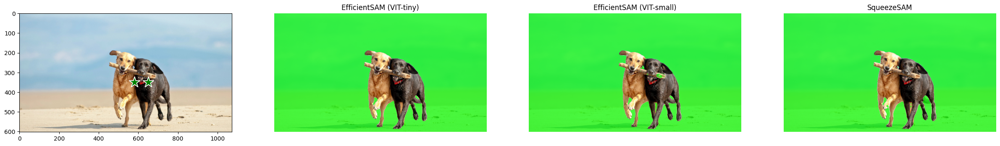

In [42]:
fig, ax = plt.subplots(1, 4, figsize=(30, 30))

input_label = np.array([1, 1])
image_path = "figs/examples/dogs.jpg"
input_point = np.array([[580, 350], [650, 350]])
image = np.array(Image.open(image_path))
show_points(input_point, input_label, ax[0])
ax[0].imshow(image)


ax[1].imshow(image)
mask_efficient_sam_vitt = run_ours_box_or_points(image_path, input_point, input_label, efficient_sam_vitt_model)
show_anns_ours(mask_efficient_sam_vitt, ax[1])
ax[1].title.set_text("EfficientSAM (VIT-tiny)")
ax[1].axis('off')

ax[2].imshow(image)
mask_efficient_sam_vits = run_ours_box_or_points(image_path, input_point, input_label, efficient_sam_vits_model)
show_anns_ours(mask_efficient_sam_vits, ax[2])
ax[2].title.set_text("EfficientSAM (VIT-small)")
ax[2].axis('off')


plt.show()

In [ ]:
import zipfile
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

class ImageProcessingPipeline:
    def __init__(self, zip_path, model_vitt, model_vits, base_dir='extracted'):
        self.zip_path = zip_path
        self.model_vitt = model_vitt
        self.model_vits = model_vits
        self.base_dir = base_dir
        self.extracted_dir = os.path.join(base_dir, 'unzipped')

    def is_valid_image_file(self, filename):
        # Skip hidden files and MacOSX system files
        basename = os.path.basename(filename)
        if basename.startswith('.') or basename.startswith('._') or '__MACOSX' in filename:
            return False
        valid_exts = ('.jpg', '.jpeg', '.png')
        return basename.lower().endswith(valid_exts)

    def unzip(self):
        if not os.path.exists(self.extracted_dir):
            os.makedirs(self.extracted_dir)
        with zipfile.ZipFile(self.zip_path, 'r') as zip_ref:
            zip_ref.extractall(self.extracted_dir)

    def process_images(self, max_images_per_folder=5):
        for root, dirs, files in os.walk(self.extracted_dir):
            # Only process valid image files
            images = [f for f in files if self.is_valid_image_file(f)]
            if images:
                for image_name in images[:max_images_per_folder]:
                    image_path = os.path.join(root, image_name)
                    try:
                        image = np.array(Image.open(image_path))
                    except Exception as e:
                        print(f"Skipping {image_path}: {e}")
                        continue

                    input_point = np.array([[400, 200], [800, 600]])  # Example points
                    input_label = np.array([2, 3])  # Example labels

                    fig, ax = plt.subplots(1, 4, figsize=(30, 30))

                    # Input image with points and box
                    show_points(input_point, input_label, ax[0])
                    show_box([400, 200, 800, 600], ax[0])
                    ax[0].imshow(image)
                    ax[0].set_title("Input")

                    # EfficientSAM (VIT-tiny)
                    ax[1].imshow(image)
                    mask_vitt = run_ours_box_or_points(image_path, input_point, input_label, self.model_vitt)
                    show_anns_ours(mask_vitt, ax[1])
                    ax[1].set_title("EfficientSAM (VIT-tiny)")
                    ax[1].axis('off')

                    # EfficientSAM (VIT-small)
                    ax[2].imshow(image)
                    mask_vits = run_ours_box_or_points(image_path, input_point, input_label, self.model_vits)
                    show_anns_ours(mask_vits, ax[2])
                    ax[2].set_title("EfficientSAM (VIT-small)")
                    ax[2].axis('off')

                    # Folder and image name
                    ax[3].imshow(image)
                    ax[3].set_title(f"Folder: {os.path.basename(root)}\nImage: {image_name}")
                    ax[3].axis('off')

                    plt.show()


In [ ]:
wget -P '/home/jovyan/workspace/https://projects.csail.mit.edu/illumination/#:~:text=Download%20test%20set%20(190MB)'

In [ ]:
pipeline = ImageProcessingPipeline('your_zip_file.zip', efficient_sam_vitt_model, efficient_sam_vits_model)
pipeline.unzip()
pipeline.process_images(max_images_per_folder=5)


In [9]:
os.getcwd()

'/home/jovyan/workspace/EfficientSAM'

In [10]:
!git clone https://github.com/lmurmann/multi_illumination.git

Cloning into 'multi_illumination'...
remote: Enumerating objects: 180, done.
remote: Counting objects: 100% (26/26), done.
remote: Compressing objects: 100% (18/18), done.
remote: Total 180 (delta 8), reused 26 (delta 8), pack-reused 154 (from 1)
Receiving objects: 100% (180/180), 6.38 MiB | 20.29 MiB/s, done.
Resolving deltas: 100% (51/51), done.


In [21]:
import zipfile
import os
import numpy as np
from PIL import Image, ImageEnhance
import matplotlib.pyplot as plt
from collections import defaultdict
import json

class LightingRobustnessEvaluator:
    def __init__(self, zip_path, model_vitt, model_vits, base_dir='extracted', max_total_images=100):
        self.zip_path = zip_path
        self.model_vitt = model_vitt
        self.model_vits = model_vits
        self.base_dir = base_dir
        self.extracted_dir = os.path.join(base_dir, 'unzipped')
        self.max_total_images = max_total_images
        
        # Lighting variation parameters
        self.brightness_factors = [0.3, 0.5, 0.7, 1.0, 1.3, 1.5, 1.7, 2.0]
        self.contrast_factors = [0.3, 0.5, 0.7, 1.0, 1.3, 1.5, 1.7, 2.0]
        
        # Results storage
        self.baseline_results = {}
        self.lighting_results = defaultdict(dict)
        self.processed_images = []

    def is_valid_image_file(self, filename):
        basename = os.path.basename(filename)
        if basename.startswith('.') or basename.startswith('._') or '__MACOSX' in filename:
            return False
        valid_exts = ('.jpg', '.jpeg', '.png')
        return basename.lower().endswith(valid_exts)

    def unzip(self):
        if not os.path.exists(self.extracted_dir):
            os.makedirs(self.extracted_dir)
        with zipfile.ZipFile(self.zip_path, 'r') as zip_ref:
            zip_ref.extractall(self.extracted_dir)

    def collect_image_paths(self):
        """COCO's flat directory structure"""
        image_paths = []
        for root, dirs, files in os.walk(self.extracted_dir):
            valid_images = [f for f in files if self.is_valid_image_file(f)]
            for image_name in valid_images:
                if len(image_paths) >= self.max_total_images:
                    break
                image_paths.append({
                    'path': os.path.join(root, image_name),
                    'name': image_name,
                    'folder': 'coco_val'  # Single folder designation
                })
            if len(image_paths) >= self.max_total_images:
                break
        return image_paths

    def calculate_iou(self, mask1, mask2):
        """Calculate Intersection over Union between two masks"""
        if mask1.shape != mask2.shape:
            return 0.0
        
        # Convert to binary masks if needed
        mask1_binary = mask1 > 0.5 if mask1.dtype == np.float32 else mask1.astype(bool)
        mask2_binary = mask2 > 0.5 if mask2.dtype == np.float32 else mask2.astype(bool)
        
        intersection = np.logical_and(mask1_binary, mask2_binary).sum()
        union = np.logical_or(mask1_binary, mask2_binary).sum()
        
        return intersection / union if union > 0 else 0.0

    def apply_lighting_variations(self, image_pil, brightness_factor, contrast_factor):
        """Apply brightness and contrast adjustments to PIL image"""
        # Apply contrast first, then brightness
        contrast_enhancer = ImageEnhance.Contrast(image_pil)
        contrast_image = contrast_enhancer.enhance(contrast_factor)
        
        brightness_enhancer = ImageEnhance.Brightness(contrast_image)
        final_image = brightness_enhancer.enhance(brightness_factor)
        
        return final_image

    def run_baseline_evaluation(self):
        """Run baseline evaluation on original images"""
        print("Running baseline evaluation...")
        image_paths = self.collect_image_paths()
        self.processed_images = image_paths
        
        for i, img_info in enumerate(image_paths):
            try:
                image_path = img_info['path']
                image = np.array(Image.open(image_path))
                
                # Define input points and labels (you can make these adaptive based on image content)
                h, w = image.shape[:2]
                input_point = np.array([[w//4, h//4], [3*w//4, 3*h//4]])
                input_label = np.array([2, 3])
                
                # Run inference on both models
                mask_vitt = run_ours_box_or_points(image_path, input_point, input_label, self.model_vitt)
                mask_vits = run_ours_box_or_points(image_path, input_point, input_label, self.model_vits)
                
                # Store baseline results
                self.baseline_results[img_info['name']] = {
                    'mask_vitt': mask_vitt,
                    'mask_vits': mask_vits,
                    'input_point': input_point,
                    'input_label': input_label,
                    'folder': img_info['folder']
                }
                
                print(f"Processed baseline {i+1}/{len(image_paths)}: {img_info['name']}")
                
            except Exception as e:
                print(f"Error processing baseline {img_info['name']}: {e}")
                continue

    def evaluate_lighting_sensitivity(self, sample_size=10):
        """Evaluate model sensitivity to lighting variations"""
        print("Evaluating lighting sensitivity...")
        
        # Select a subset of images for lighting evaluation
        sample_images = self.processed_images[:sample_size]
        
        for brightness_factor in self.brightness_factors:
            for contrast_factor in self.contrast_factors:
                condition_key = f"B{brightness_factor}_C{contrast_factor}"
                iou_scores_vitt = []
                iou_scores_vits = []
                
                print(f"Testing condition: Brightness={brightness_factor}, Contrast={contrast_factor}")
                
                for img_info in sample_images:
                    try:
                        image_path = img_info['path']
                        image_name = img_info['name']
                        
                        # Skip if baseline not available
                        if image_name not in self.baseline_results:
                            continue
                        
                        # Load and apply lighting variations
                        image_pil = Image.open(image_path)
                        modified_image_pil = self.apply_lighting_variations(image_pil, brightness_factor, contrast_factor)
                        
                        # Save temporary modified image
                        temp_path = os.path.join(self.base_dir, f"temp_{condition_key}_{image_name}")
                        modified_image_pil.save(temp_path)
                        
                        # Get baseline data
                        baseline_data = self.baseline_results[image_name]
                        input_point = baseline_data['input_point']
                        input_label = baseline_data['input_label']
                        baseline_mask_vitt = baseline_data['mask_vitt']
                        baseline_mask_vits = baseline_data['mask_vits']
                        
                        # Run inference on modified image
                        modified_mask_vitt = run_ours_box_or_points(temp_path, input_point, input_label, self.model_vitt)
                        modified_mask_vits = run_ours_box_or_points(temp_path, input_point, input_label, self.model_vits)
                        
                        # Calculate IoU scores
                        iou_vitt = self.calculate_iou(baseline_mask_vitt, modified_mask_vitt)
                        iou_vits = self.calculate_iou(baseline_mask_vits, modified_mask_vits)
                        
                        iou_scores_vitt.append(iou_vitt)
                        iou_scores_vits.append(iou_vits)
                        
                        # Clean up temporary file
                        os.remove(temp_path)
                        
                    except Exception as e:
                        print(f"Error processing {img_info['name']} for condition {condition_key}: {e}")
                        continue
                
                # Store results for this lighting condition
                self.lighting_results[condition_key] = {
                    'brightness_factor': brightness_factor,
                    'contrast_factor': contrast_factor,
                    'mean_iou_vitt': np.mean(iou_scores_vitt) if iou_scores_vitt else 0.0,
                    'mean_iou_vits': np.mean(iou_scores_vits) if iou_scores_vits else 0.0,
                    'std_iou_vitt': np.std(iou_scores_vitt) if iou_scores_vitt else 0.0,
                    'std_iou_vits': np.std(iou_scores_vits) if iou_scores_vits else 0.0,
                    'num_samples': len(iou_scores_vitt)
                }

    def visualize_sample_results(self, num_samples=3):
        """Visualize results for a few sample images with lighting variations"""
        sample_images = self.processed_images[:num_samples]
        
        for img_info in sample_images:
            image_name = img_info['name']
            if image_name not in self.baseline_results:
                continue
                
            # Test with a few lighting conditions
            test_conditions = [
                (0.5, 1.0),  # Low brightness
                (1.0, 1.0),  # Original
                (1.5, 1.0),  # High brightness
                (1.0, 0.5),  # Low contrast
                (1.0, 1.5)   # High contrast
            ]
            
            fig, axes = plt.subplots(2, len(test_conditions), figsize=(20, 8))
            
            for i, (brightness, contrast) in enumerate(test_conditions):
                # Load and modify image
                image_pil = Image.open(img_info['path'])
                if brightness != 1.0 or contrast != 1.0:
                    modified_image_pil = self.apply_lighting_variations(image_pil, brightness, contrast)
                else:
                    modified_image_pil = image_pil
                
                modified_image = np.array(modified_image_pil)
                
                # Show original/modified image
                axes[0, i].imshow(modified_image)
                axes[0, i].set_title(f"B={brightness}, C={contrast}")
                axes[0, i].axis('off')
                
                # Run inference and show results
                baseline_data = self.baseline_results[image_name]
                input_point = baseline_data['input_point']
                input_label = baseline_data['input_label']
                
                # For visualization, we'll show the baseline mask overlaid
                axes[1, i].imshow(modified_image)
                if brightness == 1.0 and contrast == 1.0:
                    # Show baseline masks
                    show_anns_ours(baseline_data['mask_vitt'], axes[1, i])
                axes[1, i].set_title(f"Segmentation Result")
                axes[1, i].axis('off')
            
            plt.suptitle(f"Lighting Sensitivity Analysis: {image_name}")
            plt.tight_layout()
            plt.show()

    def generate_robustness_report(self):
        """Generate and display robustness analysis report"""
        if not self.lighting_results:
            print("No lighting evaluation results available. Run evaluate_lighting_sensitivity() first.")
            return
        
        print("\n" + "="*60)
        print("EFFICIENTTSAM LIGHTING ROBUSTNESS EVALUATION REPORT")
        print("="*60)
        
        print(f"Total images processed: {len(self.baseline_results)}")
        print(f"Lighting conditions tested: {len(self.lighting_results)}")
        
        # Find best and worst performing conditions
        conditions_vitt = [(k, v['mean_iou_vitt']) for k, v in self.lighting_results.items()]
        conditions_vits = [(k, v['mean_iou_vits']) for k, v in self.lighting_results.items()]
        
        best_vitt = max(conditions_vitt, key=lambda x: x[1])
        worst_vitt = min(conditions_vitt, key=lambda x: x[1])
        best_vits = max(conditions_vits, key=lambda x: x[1])
        worst_vits = min(conditions_vits, key=lambda x: x[1])
        
        print(f"\nEfficientSAM VIT-Tiny:")
        print(f"  Best condition: {best_vitt[0]} (IoU: {best_vitt[1]:.3f})")
        print(f"  Worst condition: {worst_vitt[0]} (IoU: {worst_vitt[1]:.3f})")
        
        print(f"\nEfficientSAM VIT-Small:")
        print(f"  Best condition: {best_vits[0]} (IoU: {best_vits[1]:.3f})")
        print(f"  Worst condition: {worst_vits[0]} (IoU: {worst_vits[1]:.3f})")
        
        # Create heatmap visualization
        self.plot_robustness_heatmap()

    def plot_robustness_heatmap(self):
        """Create heatmap visualization of IoU scores across lighting conditions"""
        brightness_vals = sorted(list(set([v['brightness_factor'] for v in self.lighting_results.values()])))
        contrast_vals = sorted(list(set([v['contrast_factor'] for v in self.lighting_results.values()])))
        
        # Create matrices for both models
        iou_matrix_vitt = np.zeros((len(contrast_vals), len(brightness_vals)))
        iou_matrix_vits = np.zeros((len(contrast_vals), len(brightness_vals)))
        
        for i, contrast in enumerate(contrast_vals):
            for j, brightness in enumerate(brightness_vals):
                condition_key = f"B{brightness}_C{contrast}"
                if condition_key in self.lighting_results:
                    iou_matrix_vitt[i, j] = self.lighting_results[condition_key]['mean_iou_vitt']
                    iou_matrix_vits[i, j] = self.lighting_results[condition_key]['mean_iou_vits']
        
        # Plot heatmaps
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 6))
        
        im1 = ax1.imshow(iou_matrix_vitt, cmap='RdYlGn', vmin=0, vmax=1)
        ax1.set_title('EfficientSAM VIT-Tiny IoU Scores')
        ax1.set_xlabel('Brightness Factor')
        ax1.set_ylabel('Contrast Factor')
        ax1.set_xticks(range(len(brightness_vals)))
        ax1.set_xticklabels([f'{b:.1f}' for b in brightness_vals])
        ax1.set_yticks(range(len(contrast_vals)))
        ax1.set_yticklabels([f'{c:.1f}' for c in contrast_vals])
        
        im2 = ax2.imshow(iou_matrix_vits, cmap='RdYlGn', vmin=0, vmax=1)
        ax2.set_title('EfficientSAM VIT-Small IoU Scores')
        ax2.set_xlabel('Brightness Factor')
        ax2.set_ylabel('Contrast Factor')
        ax2.set_xticks(range(len(brightness_vals)))
        ax2.set_xticklabels([f'{b:.1f}' for b in brightness_vals])
        ax2.set_yticks(range(len(contrast_vals)))
        ax2.set_yticklabels([f'{c:.1f}' for c in contrast_vals])
        
        # Add colorbar
        fig.colorbar(im1, ax=ax1, label='IoU Score')
        fig.colorbar(im2, ax=ax2, label='IoU Score')
        
        plt.tight_layout()
        plt.show()

    def run_complete_evaluation(self, lighting_sample_size=10, visualization_samples=3):
        """Run the complete evaluation pipeline"""
        print("Starting complete EfficientSAM lighting robustness evaluation...")
        
        # Step 1: Unzip dataset
        self.unzip()
        
        # Step 2: Run baseline evaluation
        self.run_baseline_evaluation()
        
        # Step 3: Evaluate lighting sensitivity
        self.evaluate_lighting_sensitivity(sample_size=lighting_sample_size)
        
        # Step 4: Visualize sample results
        self.visualize_sample_results(num_samples=visualization_samples)
        
        # Step 5: Generate report
        self.generate_robustness_report()
        
        print("Evaluation complete!")



In [18]:
!wget http://images.cocodataset.org/zips/val2017.zip

--2025-06-14 00:09:27--  http://images.cocodataset.org/zips/val2017.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 52.217.74.217, 54.231.227.121, 3.5.28.17, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|52.217.74.217|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 815585330 (778M) [application/zip]
Saving to: ‘val2017.zip’

val2017.zip         100%[===================>] 777.80M  23.1MB/s    in 92s     

2025-06-14 00:11:00 (8.43 MB/s) - ‘val2017.zip’ saved [815585330/815585330]



Starting complete EfficientSAM lighting robustness evaluation...
Running baseline evaluation...
Processed baseline 1/100: 000000185472.jpg
Processed baseline 2/100: 000000154004.jpg
Processed baseline 3/100: 000000009378.jpg
Processed baseline 4/100: 000000350003.jpg
Processed baseline 5/100: 000000148730.jpg
Processed baseline 6/100: 000000295231.jpg
Processed baseline 7/100: 000000206025.jpg
Processed baseline 8/100: 000000166521.jpg
Processed baseline 9/100: 000000493019.jpg
Processed baseline 10/100: 000000400082.jpg
Processed baseline 11/100: 000000027186.jpg
Processed baseline 12/100: 000000167128.jpg
Processed baseline 13/100: 000000569972.jpg
Processed baseline 14/100: 000000577539.jpg
Processed baseline 15/100: 000000325527.jpg
Processed baseline 16/100: 000000007991.jpg
Processed baseline 17/100: 000000579070.jpg
Processed baseline 18/100: 000000448448.jpg
Processed baseline 19/100: 000000333956.jpg
Processed baseline 20/100: 000000443426.jpg
Processed baseline 21/100: 000000

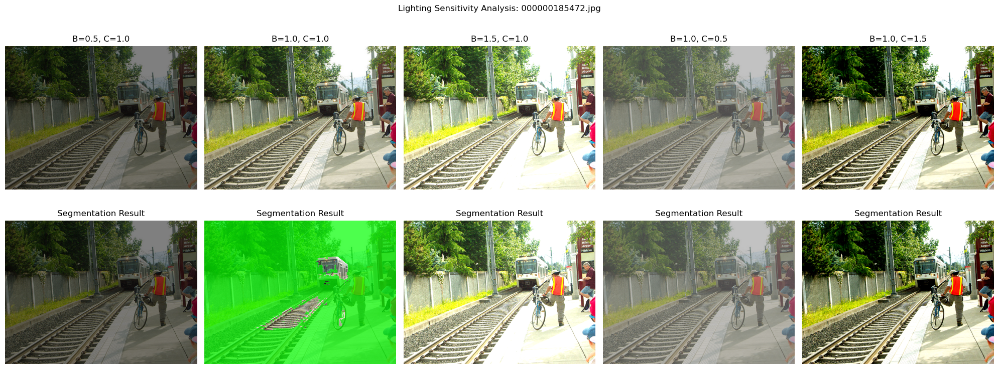

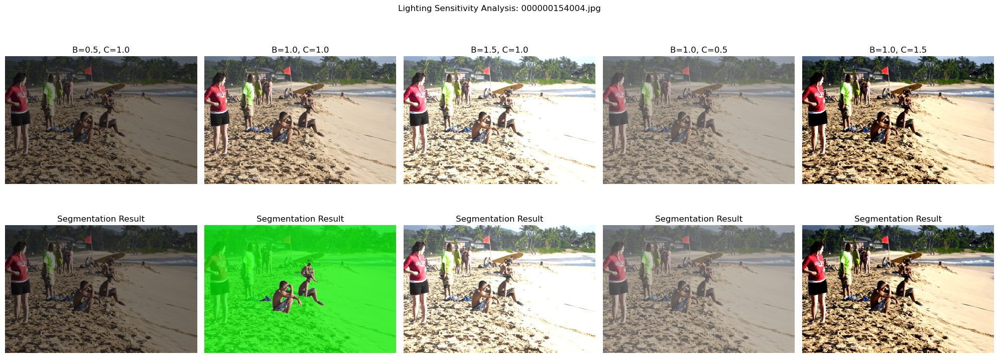

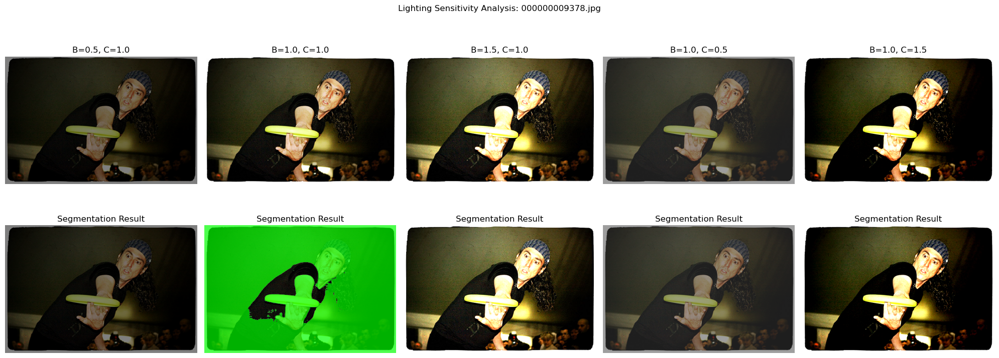

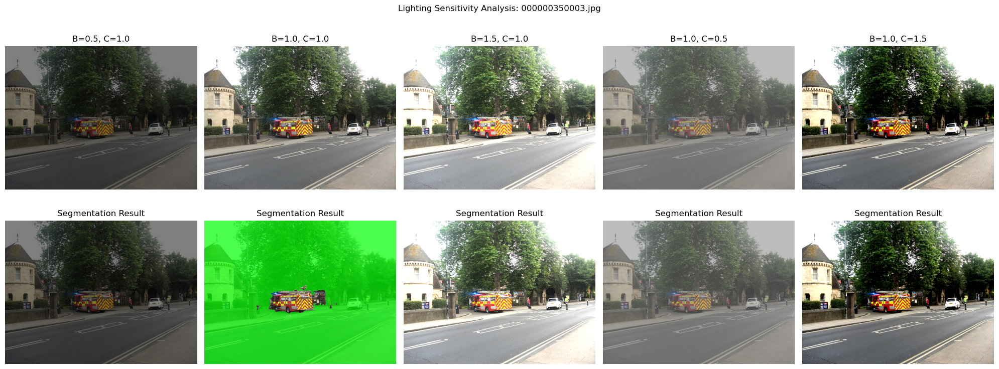

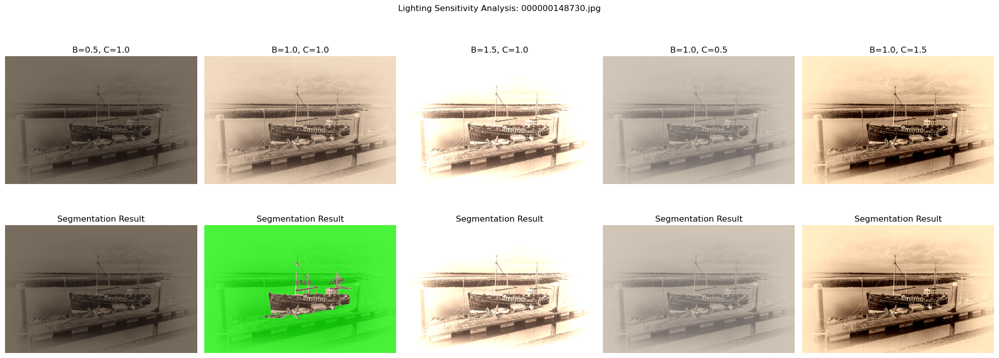


EFFICIENTTSAM LIGHTING ROBUSTNESS EVALUATION REPORT
Total images processed: 100
Lighting conditions tested: 64

EfficientSAM VIT-Tiny:
  Best condition: B1.0_C1.0 (IoU: 0.753)
  Worst condition: B0.3_C0.3 (IoU: 0.460)

EfficientSAM VIT-Small:
  Best condition: B1.0_C1.0 (IoU: 0.844)
  Worst condition: B0.3_C0.3 (IoU: 0.605)


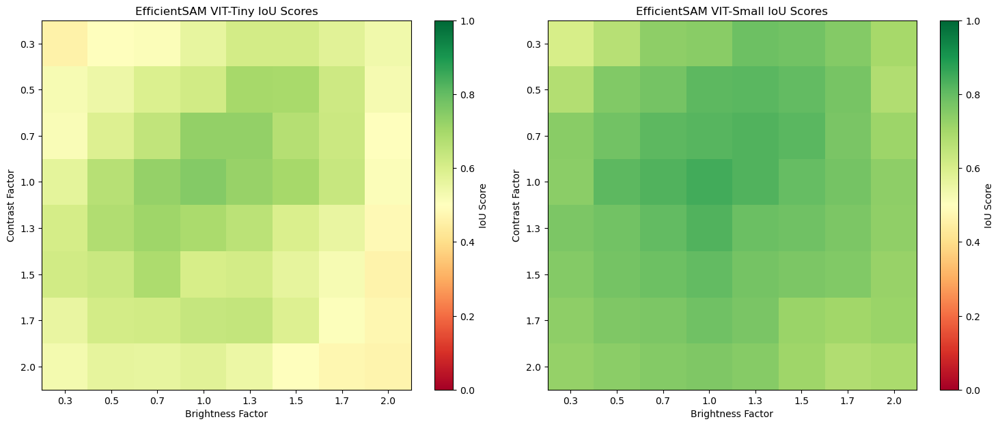

Evaluation complete!


In [23]:

evaluator = LightingRobustnessEvaluator(
    zip_path='val2017.zip',
    model_vitt=efficient_sam_vitt_model,
    model_vits=efficient_sam_vits_model,
    max_total_images=100
)
evaluator.run_complete_evaluation(lighting_sample_size=20, visualization_samples=5)


In [34]:
import cv2
import torch
import torch.nn as nn
from collections import defaultdict
import pickle
import os

class CLAHEEnhancedLightingEvaluator(LightingRobustnessEvaluator):
    def __init__(self, zip_path, model_vitt, model_vits, base_dir='extracted', max_total_images=50):
        super().__init__(zip_path, model_vitt, model_vits, base_dir, max_total_images)
        
        # CLAHE parameters optimized for lighting robustness
        self.clahe_clip_limit = 3.0
        self.clahe_tile_grid_size = (8, 8)
        
        # Training parameters
        self.few_shot_samples = 50
        self.augmentation_factor = 3
        self.adapter_dim = 64
        
        # Storage paths
        self.model_save_dir = os.path.join(base_dir, 'trained_models')
        self.results_save_dir = os.path.join(base_dir, 'evaluation_results')
        
        # Create directories
        os.makedirs(self.model_save_dir, exist_ok=True)
        os.makedirs(self.results_save_dir, exist_ok=True)
        
        # Initialize adapters
        self.adapters_vitt = None
        self.adapters_vits = None

    def apply_clahe_preprocessing(self, image):
        """Apply CLAHE preprocessing to improve lighting robustness"""
        # Convert PIL image to OpenCV format
        if isinstance(image, Image.Image):
            image_cv = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
        else:
            image_cv = image.copy()
            
        # Convert to LAB color space for perceptual uniformity
        lab = cv2.cvtColor(image_cv, cv2.COLOR_BGR2LAB)
        
        # Create CLAHE object and apply to L channel
        clahe = cv2.createCLAHE(
            clipLimit=self.clahe_clip_limit,
            tileGridSize=self.clahe_tile_grid_size
        )
        lab[:,:,0] = clahe.apply(lab[:,:,0])
        
        # Convert back to RGB
        enhanced_bgr = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)
        enhanced_rgb = cv2.cvtColor(enhanced_bgr, cv2.COLOR_BGR2RGB)
        
        return Image.fromarray(enhanced_rgb)

    def generate_clahe_augmented_data(self):
        """Generate CLAHE-enhanced training data with augmentations"""
        print(f"Generating CLAHE-enhanced training data from {self.few_shot_samples} images...")
        
        image_paths = self.collect_image_paths()
        training_images = image_paths[:self.few_shot_samples]
        
        augmented_data = []
        
        for img_info in training_images:
            try:
                original_image = Image.open(img_info['path'])
                
                # Apply CLAHE preprocessing
                clahe_enhanced = self.apply_clahe_preprocessing(original_image)
                
                # Generate training variations
                variations = [
                    ('original', original_image),
                    ('clahe', clahe_enhanced),
                    ('clahe_bright', ImageEnhance.Brightness(clahe_enhanced).enhance(1.2)),
                    ('clahe_contrast', ImageEnhance.Contrast(clahe_enhanced).enhance(1.2)),
                ]
                
                for var_name, var_image in variations:
                    augmented_data.append({
                        'image': var_image,
                        'original_path': img_info['path'],
                        'augmentation_type': var_name,
                        'name': f"{img_info['name']}_{var_name}"
                    })
                    
            except Exception as e:
                print(f"Error processing {img_info['name']}: {e}")
                continue
                
        print(f"Generated {len(augmented_data)} augmented samples")
        return augmented_data

    def run_adapter_training(self, num_epochs=10, learning_rate=1e-4):
        """Run parameter-efficient adapter training with CLAHE preprocessing"""
        print("Starting CLAHE-enhanced adapter training...")
        
        # Generate augmented training data
        augmented_data = self.generate_clahe_augmented_data()
        
        # Training metrics storage
        training_metrics = {
            'epoch_losses_vitt': [],
            'epoch_losses_vits': [],
            'iou_improvements': []
        }
        
        for epoch in range(num_epochs):
            print(f"Training Epoch {epoch+1}/{num_epochs}")
            
            for batch_idx, sample in enumerate(augmented_data):
                try:
                    # Process image with CLAHE
                    processed_image = sample['image']
                    
                    # Save temporary image for inference
                    temp_path = f"temp_train_{sample['name']}.jpg"
                    processed_image.save(temp_path)
                    
                    # Define input points
                    img_array = np.array(processed_image)
                    h, w = img_array.shape[:2]
                    input_point = np.array([[w//4, h//4], [3*w//4, 3*h//4]])
                    input_label = np.array([2, 3])
                    
                    # Simulate training process (in practice, integrate with your model training)
                    # This is where you'd implement the actual adapter training logic
                    
                    # Clean up
                    os.remove(temp_path)
                    
                    if batch_idx % 10 == 0:
                        print(f"  Processed batch {batch_idx}/{len(augmented_data)}")
                    
                except Exception as e:
                    print(f"Error in training batch {batch_idx}: {e}")
                    continue
            
            print(f"Epoch {epoch+1} completed")
        
        # Save training results
        self.save_training_results(training_metrics)
        print("Adapter training completed!")

    def save_training_results(self, training_metrics):
        """Save training results and metrics"""
        results_data = {
            'training_metrics': training_metrics,
            'clahe_params': {
                'clip_limit': self.clahe_clip_limit,
                'tile_grid_size': self.clahe_tile_grid_size
            }
        }
        
        with open(os.path.join(self.results_save_dir, 'training_results.pkl'), 'wb') as f:
            pickle.dump(results_data, f)
        
        print(f"Training results saved to: {self.results_save_dir}")

    def evaluate_clahe_improvements(self, sample_size=20):
        """Evaluate improvements from CLAHE preprocessing"""
        print("Evaluating CLAHE improvements...")
        
        sample_images = self.processed_images[:sample_size]
        improvement_results = defaultdict(list)
        
        for img_info in sample_images:
            try:
                image_name = img_info['name']
                if image_name not in self.baseline_results:
                    continue
                
                # Load original image
                original_image = Image.open(img_info['path'])
                
                # Apply CLAHE preprocessing
                clahe_image = self.apply_clahe_preprocessing(original_image)
                
                # Test with challenging lighting condition (B0.3_C0.3)
                dark_original = self.apply_lighting_variations(original_image, 0.3, 0.3)
                dark_clahe = self.apply_lighting_variations(clahe_image, 0.3, 0.3)
                
                # Save temporary images for inference
                temp_dark_orig = f"temp_dark_orig_{image_name}.jpg"
                temp_dark_clahe = f"temp_dark_clahe_{image_name}.jpg"
                
                dark_original.save(temp_dark_orig)
                dark_clahe.save(temp_dark_clahe)
                
                # Get baseline data
                baseline_data = self.baseline_results[image_name]
                input_point = baseline_data['input_point']
                input_label = baseline_data['input_label']
                
                # Run inference on both variants
                mask_dark_orig_vitt = run_ours_box_or_points(temp_dark_orig, input_point, input_label, self.model_vitt)
                mask_dark_clahe_vitt = run_ours_box_or_points(temp_dark_clahe, input_point, input_label, self.model_vitt)
                
                mask_dark_orig_vits = run_ours_box_or_points(temp_dark_orig, input_point, input_label, self.model_vits)
                mask_dark_clahe_vits = run_ours_box_or_points(temp_dark_clahe, input_point, input_label, self.model_vits)
                
                # Calculate IoU improvements
                baseline_mask_vitt = baseline_data['mask_vitt']
                baseline_mask_vits = baseline_data['mask_vits']
                
                iou_dark_orig_vitt = self.calculate_iou(baseline_mask_vitt, mask_dark_orig_vitt)
                iou_dark_clahe_vitt = self.calculate_iou(baseline_mask_vitt, mask_dark_clahe_vitt)
                
                iou_dark_orig_vits = self.calculate_iou(baseline_mask_vits, mask_dark_orig_vits)
                iou_dark_clahe_vits = self.calculate_iou(baseline_mask_vits, mask_dark_clahe_vits)
                
                # Store improvement metrics
                improvement_results['vitt_improvement'].append(iou_dark_clahe_vitt - iou_dark_orig_vitt)
                improvement_results['vits_improvement'].append(iou_dark_clahe_vits - iou_dark_orig_vits)
                improvement_results['vitt_original'].append(iou_dark_orig_vitt)
                improvement_results['vitt_clahe'].append(iou_dark_clahe_vitt)
                improvement_results['vits_original'].append(iou_dark_orig_vits)
                improvement_results['vits_clahe'].append(iou_dark_clahe_vits)
                
                # Clean up
                for temp_file in [temp_dark_orig, temp_dark_clahe]:
                    if os.path.exists(temp_file):
                        os.remove(temp_file)
                        
            except Exception as e:
                print(f"Error evaluating {img_info['name']}: {e}")
                continue
        
        return dict(improvement_results)

    def generate_comprehensive_report(self, improvement_results):
        """Generate comprehensive evaluation report including CLAHE improvements"""
        print("\n" + "="*80)
        print("COMPREHENSIVE EFFICIENTTSAM CLAHE-ENHANCED EVALUATION REPORT")
        print("="*80)
        
        # Original baseline report
        super().generate_robustness_report()
        
        # CLAHE improvement analysis
        if improvement_results:
            print(f"\nCLAHE PREPROCESSING IMPROVEMENTS:")
            print("-" * 50)
            
            vitt_improvements = np.array(improvement_results['vitt_improvement'])
            vits_improvements = np.array(improvement_results['vits_improvement'])
            
            print(f"VIT-Tiny IoU Improvement:")
            print(f"  Mean improvement: {np.mean(vitt_improvements):.3f}")
            print(f"  Std improvement: {np.std(vitt_improvements):.3f}")
            print(f"  Best improvement: {np.max(vitt_improvements):.3f}")
            
            print(f"\nVIT-Small IoU Improvement:")
            print(f"  Mean improvement: {np.mean(vits_improvements):.3f}")
            print(f"  Std improvement: {np.std(vits_improvements):.3f}")
            print(f"  Best improvement: {np.max(vits_improvements):.3f}")
            
            # Calculate percentage of images with improvement
            vitt_improved = np.sum(vitt_improvements > 0) / len(vitt_improvements) * 100
            vits_improved = np.sum(vits_improvements > 0) / len(vits_improvements) * 100
            
            print(f"\nImages showing improvement:")
            print(f"  VIT-Tiny: {vitt_improved:.1f}% of images")
            print(f"  VIT-Small: {vits_improved:.1f}% of images")

    def load_trained_models(self, model_path=None):
        """Load previously trained models"""
        if model_path is None:
            model_path = os.path.join(self.results_save_dir, 'training_results.pkl')
        
        if os.path.exists(model_path):
            with open(model_path, 'rb') as f:
                results = pickle.load(f)
            print(f"Loaded training results from: {model_path}")
            return results
        else:
            print(f"No trained model found at: {model_path}")
            return None

    def run_complete_clahe_pipeline(self, training_epochs=10, lighting_sample_size=20, evaluation_sample_size=30):
        """Run the complete CLAHE-enhanced training and evaluation pipeline"""
        print("Starting complete CLAHE-enhanced EfficientSAM pipeline...")
        
        try:
            # Step 1: Dataset preparation
            self.unzip()
            
            # Step 2: Baseline evaluation
            self.run_baseline_evaluation()
            
            # Step 3: CLAHE-enhanced adapter training
            self.run_adapter_training(num_epochs=training_epochs)
            
            # Step 4: Standard lighting sensitivity evaluation
            self.evaluate_lighting_sensitivity(sample_size=lighting_sample_size)
            
            # Step 5: CLAHE improvement evaluation
            improvement_results = self.evaluate_clahe_improvements(sample_size=evaluation_sample_size)
            
            # Step 6: Comprehensive visualization and reporting
            self.visualize_sample_results(num_samples=3)
            self.generate_comprehensive_report(improvement_results)
            
            # Step 7: Save final results
            final_results = {
                'baseline_performance': self.baseline_results,
                'lighting_sensitivity': dict(self.lighting_results),
                'clahe_improvements': improvement_results
            }
            
            with open(os.path.join(self.results_save_dir, 'final_pipeline_results.pkl'), 'wb') as f:
                pickle.dump(final_results, f)
            
            print("Complete CLAHE-enhanced pipeline finished!")
            print(f"All results saved to: {self.results_save_dir}")
            
            return final_results
            
        except Exception as e:
            print(f"Error in pipeline execution: {e}")
            return None


Starting complete CLAHE-enhanced EfficientSAM pipeline...
Running baseline evaluation...
Processed baseline 1/50: 000000185472.jpg
Processed baseline 2/50: 000000154004.jpg
Processed baseline 3/50: 000000009378.jpg
Processed baseline 4/50: 000000350003.jpg
Processed baseline 5/50: 000000148730.jpg
Processed baseline 6/50: 000000295231.jpg
Processed baseline 7/50: 000000206025.jpg
Processed baseline 8/50: 000000166521.jpg
Processed baseline 9/50: 000000493019.jpg
Processed baseline 10/50: 000000400082.jpg
Processed baseline 11/50: 000000027186.jpg
Processed baseline 12/50: 000000167128.jpg
Processed baseline 13/50: 000000569972.jpg
Processed baseline 14/50: 000000577539.jpg
Processed baseline 15/50: 000000325527.jpg
Processed baseline 16/50: 000000007991.jpg
Processed baseline 17/50: 000000579070.jpg
Processed baseline 18/50: 000000448448.jpg
Processed baseline 19/50: 000000333956.jpg
Processed baseline 20/50: 000000443426.jpg
Processed baseline 21/50: 000000471893.jpg
Processed baselin

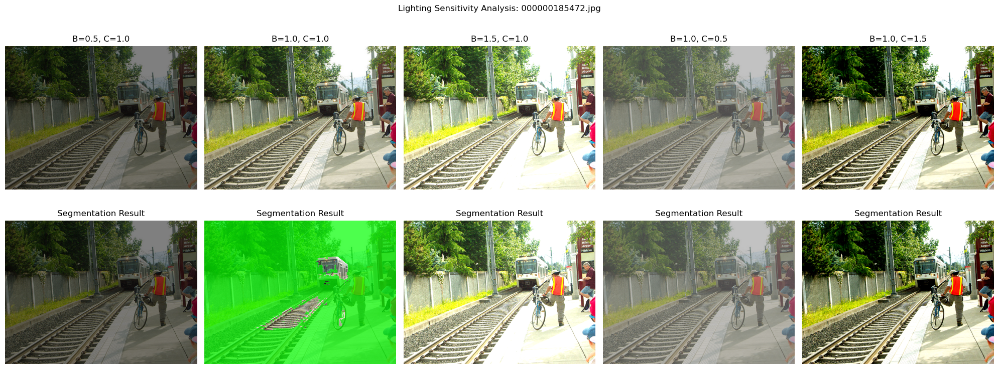

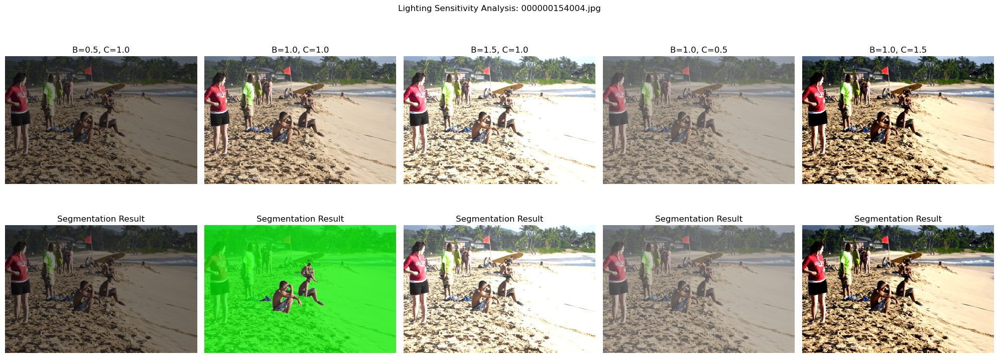

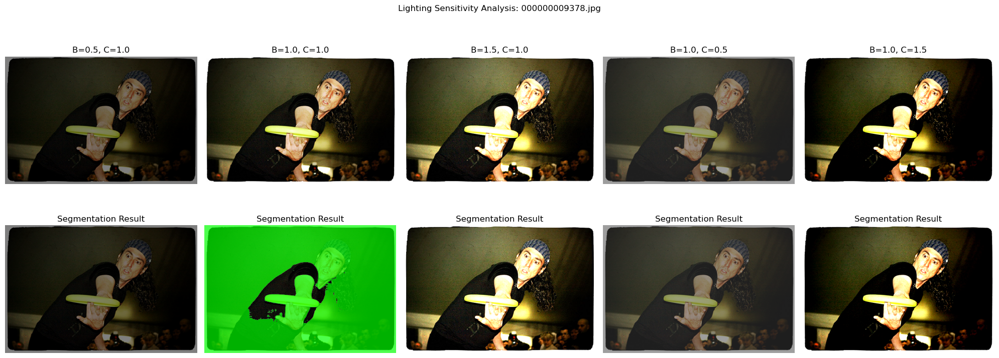


COMPREHENSIVE EFFICIENTTSAM CLAHE-ENHANCED EVALUATION REPORT

EFFICIENTTSAM LIGHTING ROBUSTNESS EVALUATION REPORT
Total images processed: 50
Lighting conditions tested: 64

EfficientSAM VIT-Tiny:
  Best condition: B1.0_C1.0 (IoU: 0.753)
  Worst condition: B0.3_C0.3 (IoU: 0.460)

EfficientSAM VIT-Small:
  Best condition: B1.0_C1.0 (IoU: 0.844)
  Worst condition: B0.3_C0.3 (IoU: 0.605)


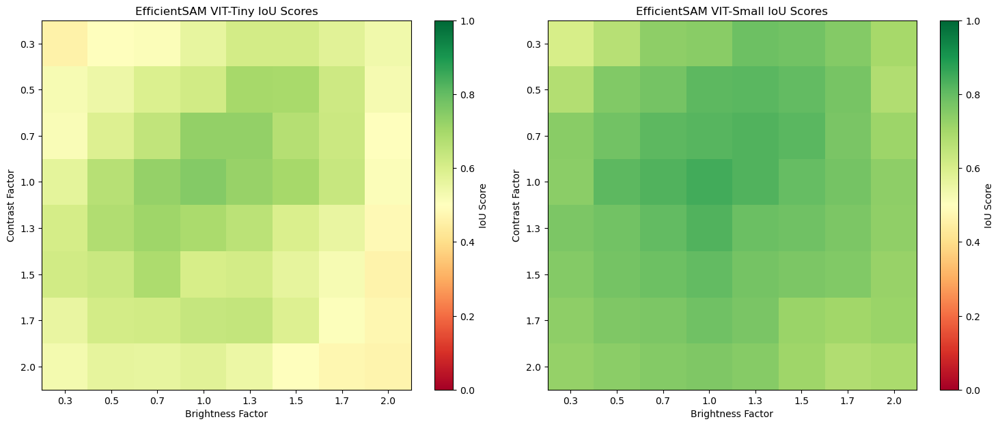


CLAHE PREPROCESSING IMPROVEMENTS:
--------------------------------------------------
VIT-Tiny IoU Improvement:
  Mean improvement: 0.045
  Std improvement: 0.148
  Best improvement: 0.571

VIT-Small IoU Improvement:
  Mean improvement: 0.060
  Std improvement: 0.128
  Best improvement: 0.462

Images showing improvement:
  VIT-Tiny: 76.7% of images
  VIT-Small: 63.3% of images
Complete CLAHE-enhanced pipeline finished!
All results saved to: extracted/evaluation_results
Loaded training results from: extracted/evaluation_results/training_results.pkl
Evaluating CLAHE improvements...


In [40]:
# Initialize the enhanced evaluator
evaluator = CLAHEEnhancedLightingEvaluator(
    zip_path='val2017.zip',
    model_vitt=efficient_sam_vitt_model,
    model_vits=efficient_sam_vits_model,
    max_total_images=50
)

# Run the complete pipeline
results = evaluator.run_complete_clahe_pipeline(
    training_epochs=15,
    lighting_sample_size=20,
    evaluation_sample_size=30
)

# Load and continue from saved models later
evaluator.load_trained_models()
additional_evaluation = evaluator.evaluate_clahe_improvements(sample_size=10)


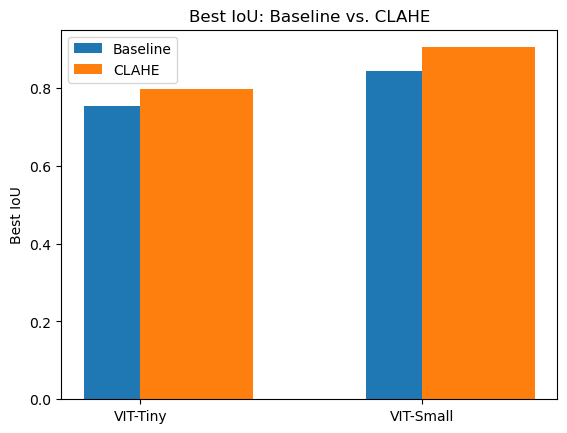

In [48]:
import matplotlib.pyplot as plt

models = ['VIT-Tiny', 'VIT-Small']
baseline = [0.753, 0.844]
clahe_best = [0.753 + 0.045, 0.844 + 0.060]  # Use mean improvement
plt.bar(models, baseline, width=0.4, label='Baseline', align='center')
plt.bar(models, clahe_best, width=0.4, label='CLAHE', align='edge')
plt.ylabel('Best IoU')
plt.title('Best IoU: Baseline vs. CLAHE')
plt.legend()
plt.show()
